In [1]:
from tqdm import trange, notebook            # show progress-bar

# 필요한 패키지들을 설치 및 임포트

In [4]:
!pip install torch matplotlib torchvision numpy

Random Seed:  999


In [2]:
!pip install opencv-python
!pip install --upgrade pip

In [16]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# 코드 실행결과의 동일성을 위해 무작위 시드를 설정합니다
manualSeed = 999
#manualSeed = random.randint(1, 10000) # 만일 새로운 결과를 원한다면 주석을 없애면 됩니다
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


# 적대적 생성 신경망을 학습시키기 위한 설정값 지정

In [50]:
# 데이터셋의 경로
dataroot = "dataset/Hands"

# dataloader에서 사용할 쓰레드 수
workers = 2

# 배치 크기
batch_size = 128

# 이미지의 크기입니다. 모든 이미지를 변환하여 64로 크기가 통일됩니다.
image_size = 64

# 이미지의 채널 수로, RGB 이미지이기 때문에 3으로 설정합니다.
nc = 3

# 잠재공간 벡터의 크기 (예. 생성자의 입력값 크기)
nz = 100

# 생성자를 통과하는 특징 데이터들의 채널 크기
ngf = 64

# 구분자를 통과하는 특징 데이터들의 채널 크기
ndf = 64

# 학습할 에폭 수
num_epochs = 50

# 옵티마이저의 학습률
lr = 0.0002

# Adam 옵티마이저의 beta1 하이퍼파라미터
beta1 = 0.5

# 사용가능한 gpu 번호. CPU를 사용해야 하는경우 0으로 설정하세요
ngpu = 1

from torchvision import transforms, datasets

# Augmentation 이미지 증강

In [7]:
# import random
# import numpy as np
# import os
# import cv2
# import glob
# from PIL import Image
# import PIL.ImageOps

# #다음 변수를 수정하여 새로 만들 이미지 갯수를 정합니다.
# num_augmented_images = 5000

# file_path = 'dataset/Hands/Hand/' # 읽을 파일
# file_names = os.listdir(file_path)
# total_origin_image_num = len(file_names)
# augment_cnt = 1

# for i in range(1, num_augmented_images):
#     change_picture_index = random.randrange(1, total_origin_image_num-1)
#     print(change_picture_index)
#     print(file_names[change_picture_index])
#     file_name = file_names[change_picture_index]

#     origin_image_path = 'dataset/Hands/Hand/' + file_name # 읽을 파일 + file_name
#     print(origin_image_path)
#     image = Image.open(origin_image_path)
#     random_augment = random.randrange(1,4)

#     if(random_augment == 1):
#         #이미지 좌우 반전
#         print("invert")
#         inverted_image = image.transpose(Image.FLIP_LEFT_RIGHT)
#         inverted_image.save('dataset/Hands/Hand/' + 'inverted' + str(augment_cnt) + '.png') 
#         # 저장

#     elif(random_augment == 2):
#         #이미지 기울이기
#         print("rotate")
#         rotated_image = image.rotate(random.randrange(-20, 20))
#         rotated_image.save('dataset/Hands/Hand/' + 'rotated' + str(augment_cnt) + '.png')

#     augment_cnt += 1

10607
Hand_0011253.jpg
dataset/Hands/Hand/Hand_0011253.jpg
rotate
10577
Hand_0011223.jpg
dataset/Hands/Hand/Hand_0011223.jpg
invert
2444
Hand_0002765.jpg
dataset/Hands/Hand/Hand_0002765.jpg
rotate
871
Hand_0001056.jpg
dataset/Hands/Hand/Hand_0001056.jpg
4157
Hand_0004535.jpg
dataset/Hands/Hand/Hand_0004535.jpg
rotate
10344
Hand_0010979.jpg
dataset/Hands/Hand/Hand_0010979.jpg
rotate
4421
Hand_0004804.jpg
dataset/Hands/Hand/Hand_0004804.jpg
invert
3280
Hand_0003613.jpg
dataset/Hands/Hand/Hand_0003613.jpg
8197
Hand_0008699.jpg
dataset/Hands/Hand/Hand_0008699.jpg
invert
3053
Hand_0003384.jpg
dataset/Hands/Hand/Hand_0003384.jpg
5419
Hand_0005825.jpg
dataset/Hands/Hand/Hand_0005825.jpg
invert
1417
Hand_0001702.jpg
dataset/Hands/Hand/Hand_0001702.jpg
9752
Hand_0010356.jpg
dataset/Hands/Hand/Hand_0010356.jpg
rotate
2126
Hand_0002445.jpg
dataset/Hands/Hand/Hand_0002445.jpg
10708
Hand_0011359.jpg
dataset/Hands/Hand/Hand_0011359.jpg
rotate
241
Hand_0000286.jpg
dataset/Hands/Hand/Hand_0000286.jpg


1270
Hand_0001531.jpg
dataset/Hands/Hand/Hand_0001531.jpg
rotate
1461
Hand_0001747.jpg
dataset/Hands/Hand/Hand_0001747.jpg
invert
3988
Hand_0004366.jpg
dataset/Hands/Hand/Hand_0004366.jpg
164
Hand_0000204.jpg
dataset/Hands/Hand/Hand_0000204.jpg
invert
4620
Hand_0005013.jpg
dataset/Hands/Hand/Hand_0005013.jpg
rotate
1584
Hand_0001873.jpg
dataset/Hands/Hand/Hand_0001873.jpg
rotate
7188
Hand_0007650.jpg
dataset/Hands/Hand/Hand_0007650.jpg
10770
Hand_0011425.jpg
dataset/Hands/Hand/Hand_0011425.jpg
9961
Hand_0010579.jpg
dataset/Hands/Hand/Hand_0010579.jpg
9758
Hand_0010362.jpg
dataset/Hands/Hand/Hand_0010362.jpg
rotate
8439
Hand_0008948.jpg
dataset/Hands/Hand/Hand_0008948.jpg
invert
9674
Hand_0010273.jpg
dataset/Hands/Hand/Hand_0010273.jpg
rotate
7315
Hand_0007779.jpg
dataset/Hands/Hand/Hand_0007779.jpg
rotate
5625
Hand_0006034.jpg
dataset/Hands/Hand/Hand_0006034.jpg
10714
Hand_0011365.jpg
dataset/Hands/Hand/Hand_0011365.jpg
invert
8112
Hand_0008603.jpg
dataset/Hands/Hand/Hand_0008603.jpg
i

4746
Hand_0005139.jpg
dataset/Hands/Hand/Hand_0005139.jpg
rotate
2410
Hand_0002731.jpg
dataset/Hands/Hand/Hand_0002731.jpg
rotate
6808
Hand_0007256.jpg
dataset/Hands/Hand/Hand_0007256.jpg
invert
10460
Hand_0011102.jpg
dataset/Hands/Hand/Hand_0011102.jpg
invert
6350
Hand_0006785.jpg
dataset/Hands/Hand/Hand_0006785.jpg
invert
4586
Hand_0004979.jpg
dataset/Hands/Hand/Hand_0004979.jpg
invert
8142
Hand_0008634.jpg
dataset/Hands/Hand/Hand_0008634.jpg
invert
8762
Hand_0009289.jpg
dataset/Hands/Hand/Hand_0009289.jpg
11044
Hand_0011711.jpg
dataset/Hands/Hand/Hand_0011711.jpg
invert
935
Hand_0001137.jpg
dataset/Hands/Hand/Hand_0001137.jpg
invert
9118
Hand_0009685.jpg
dataset/Hands/Hand/Hand_0009685.jpg
rotate
2858
Hand_0003186.jpg
dataset/Hands/Hand/Hand_0003186.jpg
9333
Hand_0009901.jpg
dataset/Hands/Hand/Hand_0009901.jpg
rotate
10509
Hand_0011154.jpg
dataset/Hands/Hand/Hand_0011154.jpg
invert
5843
Hand_0006270.jpg
dataset/Hands/Hand/Hand_0006270.jpg
invert
7233
Hand_0007695.jpg
dataset/Hands/H

4638
Hand_0005031.jpg
dataset/Hands/Hand/Hand_0005031.jpg
rotate
6757
Hand_0007197.jpg
dataset/Hands/Hand/Hand_0007197.jpg
rotate
2102
Hand_0002421.jpg
dataset/Hands/Hand/Hand_0002421.jpg
rotate
6618
Hand_0007057.jpg
dataset/Hands/Hand/Hand_0007057.jpg
4481
Hand_0004871.jpg
dataset/Hands/Hand/Hand_0004871.jpg
invert
3229
Hand_0003561.jpg
dataset/Hands/Hand/Hand_0003561.jpg
invert
9626
Hand_0010221.jpg
dataset/Hands/Hand/Hand_0010221.jpg
6173
Hand_0006606.jpg
dataset/Hands/Hand/Hand_0006606.jpg
rotate
4226
Hand_0004608.jpg
dataset/Hands/Hand/Hand_0004608.jpg
rotate
3592
Hand_0003957.jpg
dataset/Hands/Hand/Hand_0003957.jpg
invert
3225
Hand_0003557.jpg
dataset/Hands/Hand/Hand_0003557.jpg
4353
Hand_0004736.jpg
dataset/Hands/Hand/Hand_0004736.jpg
rotate
3755
Hand_0004131.jpg
dataset/Hands/Hand/Hand_0004131.jpg
rotate
2230
Hand_0002551.jpg
dataset/Hands/Hand/Hand_0002551.jpg
invert
5220
Hand_0005625.jpg
dataset/Hands/Hand/Hand_0005625.jpg
invert
1793
Hand_0002093.jpg
dataset/Hands/Hand/Hand_

10085
Hand_0010715.jpg
dataset/Hands/Hand/Hand_0010715.jpg
invert
7670
Hand_0008148.jpg
dataset/Hands/Hand/Hand_0008148.jpg
rotate
9504
Hand_0010088.jpg
dataset/Hands/Hand/Hand_0010088.jpg
rotate
1654
Hand_0001944.jpg
dataset/Hands/Hand/Hand_0001944.jpg
2255
Hand_0002576.jpg
dataset/Hands/Hand/Hand_0002576.jpg
10164
Hand_0010796.jpg
dataset/Hands/Hand/Hand_0010796.jpg
1368
Hand_0001649.jpg
dataset/Hands/Hand/Hand_0001649.jpg
6346
Hand_0006781.jpg
dataset/Hands/Hand/Hand_0006781.jpg
rotate
1931
Hand_0002237.jpg
dataset/Hands/Hand/Hand_0002237.jpg
rotate
9312
Hand_0009880.jpg
dataset/Hands/Hand/Hand_0009880.jpg
8809
Hand_0009347.jpg
dataset/Hands/Hand/Hand_0009347.jpg
invert
8846
Hand_0009399.jpg
dataset/Hands/Hand/Hand_0009399.jpg
rotate
10078
Hand_0010708.jpg
dataset/Hands/Hand/Hand_0010708.jpg
invert
10255
Hand_0010887.jpg
dataset/Hands/Hand/Hand_0010887.jpg
rotate
1808
Hand_0002110.jpg
dataset/Hands/Hand/Hand_0002110.jpg
rotate
423
Hand_0000528.jpg
dataset/Hands/Hand/Hand_0000528.jpg

10528
Hand_0011173.jpg
dataset/Hands/Hand/Hand_0011173.jpg
3664
Hand_0004038.jpg
dataset/Hands/Hand/Hand_0004038.jpg
invert
8436
Hand_0008945.jpg
dataset/Hands/Hand/Hand_0008945.jpg
invert
10949
Hand_0011610.jpg
dataset/Hands/Hand/Hand_0011610.jpg
rotate
1567
Hand_0001856.jpg
dataset/Hands/Hand/Hand_0001856.jpg
invert
1049
Hand_0001264.jpg
dataset/Hands/Hand/Hand_0001264.jpg
rotate
9137
Hand_0009704.jpg
dataset/Hands/Hand/Hand_0009704.jpg
rotate
10126
Hand_0010756.jpg
dataset/Hands/Hand/Hand_0010756.jpg
invert
10267
Hand_0010899.jpg
dataset/Hands/Hand/Hand_0010899.jpg
invert
1004
Hand_0001210.jpg
dataset/Hands/Hand/Hand_0001210.jpg
invert
11049
Hand_0011716.jpg
dataset/Hands/Hand/Hand_0011716.jpg
rotate
7324
Hand_0007788.jpg
dataset/Hands/Hand/Hand_0007788.jpg
1675
Hand_0001966.jpg
dataset/Hands/Hand/Hand_0001966.jpg
invert
3418
Hand_0003781.jpg
dataset/Hands/Hand/Hand_0003781.jpg
invert
10811
Hand_0011468.jpg
dataset/Hands/Hand/Hand_0011468.jpg
invert
3060
Hand_0003391.jpg
dataset/Han

9271
Hand_0009839.jpg
dataset/Hands/Hand/Hand_0009839.jpg
rotate
7686
Hand_0008164.jpg
dataset/Hands/Hand/Hand_0008164.jpg
534
Hand_0000657.jpg
dataset/Hands/Hand/Hand_0000657.jpg
invert
6750
Hand_0007190.jpg
dataset/Hands/Hand/Hand_0007190.jpg
invert
4668
Hand_0005061.jpg
dataset/Hands/Hand/Hand_0005061.jpg
invert
10573
Hand_0011219.jpg
dataset/Hands/Hand/Hand_0011219.jpg
rotate
8718
Hand_0009238.jpg
dataset/Hands/Hand/Hand_0009238.jpg
3760
Hand_0004136.jpg
dataset/Hands/Hand/Hand_0004136.jpg
5136
Hand_0005540.jpg
dataset/Hands/Hand/Hand_0005540.jpg
2180
Hand_0002501.jpg
dataset/Hands/Hand/Hand_0002501.jpg
invert
4123
Hand_0004501.jpg
dataset/Hands/Hand/Hand_0004501.jpg
rotate
8556
Hand_0009073.jpg
dataset/Hands/Hand/Hand_0009073.jpg
rotate
2595
Hand_0002921.jpg
dataset/Hands/Hand/Hand_0002921.jpg
10365
Hand_0011002.jpg
dataset/Hands/Hand/Hand_0011002.jpg
rotate
3026
Hand_0003357.jpg
dataset/Hands/Hand/Hand_0003357.jpg
2357
Hand_0002678.jpg
dataset/Hands/Hand/Hand_0002678.jpg
invert
5

7588
Hand_0008065.jpg
dataset/Hands/Hand/Hand_0008065.jpg
invert
2259
Hand_0002580.jpg
dataset/Hands/Hand/Hand_0002580.jpg
4165
Hand_0004543.jpg
dataset/Hands/Hand/Hand_0004543.jpg
invert
3533
Hand_0003896.jpg
dataset/Hands/Hand/Hand_0003896.jpg
rotate
9938
Hand_0010554.jpg
dataset/Hands/Hand/Hand_0010554.jpg
5325
Hand_0005730.jpg
dataset/Hands/Hand/Hand_0005730.jpg
rotate
5236
Hand_0005641.jpg
dataset/Hands/Hand/Hand_0005641.jpg
invert
3727
Hand_0004103.jpg
dataset/Hands/Hand/Hand_0004103.jpg
rotate
678
Hand_0000826.jpg
dataset/Hands/Hand/Hand_0000826.jpg
10857
Hand_0011516.jpg
dataset/Hands/Hand/Hand_0011516.jpg
rotate
7025
Hand_0007485.jpg
dataset/Hands/Hand/Hand_0007485.jpg
rotate
3463
Hand_0003826.jpg
dataset/Hands/Hand/Hand_0003826.jpg
rotate
5057
Hand_0005460.jpg
dataset/Hands/Hand/Hand_0005460.jpg
invert
3194
Hand_0003526.jpg
dataset/Hands/Hand/Hand_0003526.jpg
2993
Hand_0003324.jpg
dataset/Hands/Hand/Hand_0003324.jpg
rotate
548
Hand_0000673.jpg
dataset/Hands/Hand/Hand_0000673.

8003
Hand_0008490.jpg
dataset/Hands/Hand/Hand_0008490.jpg
10046
Hand_0010673.jpg
dataset/Hands/Hand/Hand_0010673.jpg
invert
2808
Hand_0003135.jpg
dataset/Hands/Hand/Hand_0003135.jpg
rotate
10022
Hand_0010648.jpg
dataset/Hands/Hand/Hand_0010648.jpg
rotate
9275
Hand_0009843.jpg
dataset/Hands/Hand/Hand_0009843.jpg
invert
5989
Hand_0006419.jpg
dataset/Hands/Hand/Hand_0006419.jpg
4921
Hand_0005322.jpg
dataset/Hands/Hand/Hand_0005322.jpg
invert
5577
Hand_0005986.jpg
dataset/Hands/Hand/Hand_0005986.jpg
rotate
10717
Hand_0011369.jpg
dataset/Hands/Hand/Hand_0011369.jpg
2255
Hand_0002576.jpg
dataset/Hands/Hand/Hand_0002576.jpg
rotate
7222
Hand_0007684.jpg
dataset/Hands/Hand/Hand_0007684.jpg
rotate
3338
Hand_0003691.jpg
dataset/Hands/Hand/Hand_0003691.jpg
rotate
4256
Hand_0004639.jpg
dataset/Hands/Hand/Hand_0004639.jpg
5494
Hand_0005903.jpg
dataset/Hands/Hand/Hand_0005903.jpg
invert
6823
Hand_0007272.jpg
dataset/Hands/Hand/Hand_0007272.jpg
rotate
5192
Hand_0005597.jpg
dataset/Hands/Hand/Hand_0005

576
Hand_0000705.jpg
dataset/Hands/Hand/Hand_0000705.jpg
rotate
5479
Hand_0005888.jpg
dataset/Hands/Hand/Hand_0005888.jpg
944
Hand_0001149.jpg
dataset/Hands/Hand/Hand_0001149.jpg
8080
Hand_0008570.jpg
dataset/Hands/Hand/Hand_0008570.jpg
invert
2773
Hand_0003100.jpg
dataset/Hands/Hand/Hand_0003100.jpg
rotate
6435
Hand_0006872.jpg
dataset/Hands/Hand/Hand_0006872.jpg
invert
4358
Hand_0004741.jpg
dataset/Hands/Hand/Hand_0004741.jpg
24
Hand_0000029.jpg
dataset/Hands/Hand/Hand_0000029.jpg
rotate
4199
Hand_0004581.jpg
dataset/Hands/Hand/Hand_0004581.jpg
rotate
10791
Hand_0011447.jpg
dataset/Hands/Hand/Hand_0011447.jpg
rotate
3000
Hand_0003331.jpg
dataset/Hands/Hand/Hand_0003331.jpg
invert
9288
Hand_0009856.jpg
dataset/Hands/Hand/Hand_0009856.jpg
rotate
8602
Hand_0009120.jpg
dataset/Hands/Hand/Hand_0009120.jpg
9748
Hand_0010352.jpg
dataset/Hands/Hand/Hand_0010352.jpg
invert
9983
Hand_0010607.jpg
dataset/Hands/Hand/Hand_0010607.jpg
invert
10575
Hand_0011221.jpg
dataset/Hands/Hand/Hand_0011221.j

6172
Hand_0006605.jpg
dataset/Hands/Hand/Hand_0006605.jpg
rotate
6403
Hand_0006839.jpg
dataset/Hands/Hand/Hand_0006839.jpg
rotate
3511
Hand_0003874.jpg
dataset/Hands/Hand/Hand_0003874.jpg
invert
9757
Hand_0010361.jpg
dataset/Hands/Hand/Hand_0010361.jpg
rotate
721
Hand_0000881.jpg
dataset/Hands/Hand/Hand_0000881.jpg
1578
Hand_0001867.jpg
dataset/Hands/Hand/Hand_0001867.jpg
rotate
2960
Hand_0003290.jpg
dataset/Hands/Hand/Hand_0003290.jpg
rotate
8389
Hand_0008896.jpg
dataset/Hands/Hand/Hand_0008896.jpg
6788
Hand_0007236.jpg
dataset/Hands/Hand/Hand_0007236.jpg
7399
Hand_0007864.jpg
dataset/Hands/Hand/Hand_0007864.jpg
rotate
6546
Hand_0006985.jpg
dataset/Hands/Hand/Hand_0006985.jpg
6433
Hand_0006870.jpg
dataset/Hands/Hand/Hand_0006870.jpg
7064
Hand_0007524.jpg
dataset/Hands/Hand/Hand_0007524.jpg
invert
7358
Hand_0007823.jpg
dataset/Hands/Hand/Hand_0007823.jpg
invert
572
Hand_0000701.jpg
dataset/Hands/Hand/Hand_0000701.jpg
rotate
4176
Hand_0004554.jpg
dataset/Hands/Hand/Hand_0004554.jpg
rota

1157
Hand_0001383.jpg
dataset/Hands/Hand/Hand_0001383.jpg
invert
8284
Hand_0008787.jpg
dataset/Hands/Hand/Hand_0008787.jpg
10389
Hand_0011029.jpg
dataset/Hands/Hand/Hand_0011029.jpg
rotate
3449
Hand_0003812.jpg
dataset/Hands/Hand/Hand_0003812.jpg
3796
Hand_0004172.jpg
dataset/Hands/Hand/Hand_0004172.jpg
rotate
5249
Hand_0005654.jpg
dataset/Hands/Hand/Hand_0005654.jpg
rotate
3607
Hand_0003979.jpg
dataset/Hands/Hand/Hand_0003979.jpg
2143
Hand_0002462.jpg
dataset/Hands/Hand/Hand_0002462.jpg
invert
7632
Hand_0008109.jpg
dataset/Hands/Hand/Hand_0008109.jpg
invert
2435
Hand_0002756.jpg
dataset/Hands/Hand/Hand_0002756.jpg
rotate
2790
Hand_0003117.jpg
dataset/Hands/Hand/Hand_0003117.jpg
rotate
7552
Hand_0008029.jpg
dataset/Hands/Hand/Hand_0008029.jpg
invert
7716
Hand_0008197.jpg
dataset/Hands/Hand/Hand_0008197.jpg
rotate
9939
Hand_0010555.jpg
dataset/Hands/Hand/Hand_0010555.jpg
invert
6455
Hand_0006892.jpg
dataset/Hands/Hand/Hand_0006892.jpg
invert
8059
Hand_0008548.jpg
dataset/Hands/Hand/Hand

939
Hand_0001141.jpg
dataset/Hands/Hand/Hand_0001141.jpg
11038
Hand_0011704.jpg
dataset/Hands/Hand/Hand_0011704.jpg
6169
Hand_0006602.jpg
dataset/Hands/Hand/Hand_0006602.jpg
rotate
10049
Hand_0010676.jpg
dataset/Hands/Hand/Hand_0010676.jpg
invert
1779
Hand_0002079.jpg
dataset/Hands/Hand/Hand_0002079.jpg
invert
3952
Hand_0004330.jpg
dataset/Hands/Hand/Hand_0004330.jpg
rotate
3998
Hand_0004376.jpg
dataset/Hands/Hand/Hand_0004376.jpg
rotate
534
Hand_0000657.jpg
dataset/Hands/Hand/Hand_0000657.jpg
invert
1261
Hand_0001519.jpg
dataset/Hands/Hand/Hand_0001519.jpg
rotate
9004
Hand_0009570.jpg
dataset/Hands/Hand/Hand_0009570.jpg
invert
5831
Hand_0006258.jpg
dataset/Hands/Hand/Hand_0006258.jpg
4923
Hand_0005324.jpg
dataset/Hands/Hand/Hand_0005324.jpg
10783
Hand_0011438.jpg
dataset/Hands/Hand/Hand_0011438.jpg
invert
3118
Hand_0003449.jpg
dataset/Hands/Hand/Hand_0003449.jpg
invert
1647
Hand_0001937.jpg
dataset/Hands/Hand/Hand_0001937.jpg
4199
Hand_0004581.jpg
dataset/Hands/Hand/Hand_0004581.jpg
4

10408
Hand_0011049.jpg
dataset/Hands/Hand/Hand_0011049.jpg
invert
2046
Hand_0002354.jpg
dataset/Hands/Hand/Hand_0002354.jpg
3340
Hand_0003693.jpg
dataset/Hands/Hand/Hand_0003693.jpg
rotate
1394
Hand_0001676.jpg
dataset/Hands/Hand/Hand_0001676.jpg
rotate
1028
Hand_0001243.jpg
dataset/Hands/Hand/Hand_0001243.jpg
9491
Hand_0010075.jpg
dataset/Hands/Hand/Hand_0010075.jpg
10320
Hand_0010954.jpg
dataset/Hands/Hand/Hand_0010954.jpg
rotate
815
Hand_0000989.jpg
dataset/Hands/Hand/Hand_0000989.jpg
991
Hand_0001196.jpg
dataset/Hands/Hand/Hand_0001196.jpg
invert
6497
Hand_0006934.jpg
dataset/Hands/Hand/Hand_0006934.jpg
5488
Hand_0005897.jpg
dataset/Hands/Hand/Hand_0005897.jpg
9510
Hand_0010095.jpg
dataset/Hands/Hand/Hand_0010095.jpg
5903
Hand_0006330.jpg
dataset/Hands/Hand/Hand_0006330.jpg
invert
5490
Hand_0005899.jpg
dataset/Hands/Hand/Hand_0005899.jpg
invert
3692
Hand_0004068.jpg
dataset/Hands/Hand/Hand_0004068.jpg
rotate
6537
Hand_0006976.jpg
dataset/Hands/Hand/Hand_0006976.jpg
invert
4841
Hand

3817
Hand_0004193.jpg
dataset/Hands/Hand/Hand_0004193.jpg
3183
Hand_0003515.jpg
dataset/Hands/Hand/Hand_0003515.jpg
rotate
6412
Hand_0006849.jpg
dataset/Hands/Hand/Hand_0006849.jpg
rotate
8222
Hand_0008725.jpg
dataset/Hands/Hand/Hand_0008725.jpg
8443
Hand_0008953.jpg
dataset/Hands/Hand/Hand_0008953.jpg
rotate
5350
Hand_0005755.jpg
dataset/Hands/Hand/Hand_0005755.jpg
rotate
1496
Hand_0001783.jpg
dataset/Hands/Hand/Hand_0001783.jpg
invert
2031
Hand_0002339.jpg
dataset/Hands/Hand/Hand_0002339.jpg
rotate
855
Hand_0001038.jpg
dataset/Hands/Hand/Hand_0001038.jpg
rotate
3190
Hand_0003522.jpg
dataset/Hands/Hand/Hand_0003522.jpg
rotate
7939
Hand_0008426.jpg
dataset/Hands/Hand/Hand_0008426.jpg
rotate
7220
Hand_0007682.jpg
dataset/Hands/Hand/Hand_0007682.jpg
rotate
10257
Hand_0010889.jpg
dataset/Hands/Hand/Hand_0010889.jpg
3689
Hand_0004065.jpg
dataset/Hands/Hand/Hand_0004065.jpg
8970
Hand_0009525.jpg
dataset/Hands/Hand/Hand_0009525.jpg
rotate
1452
Hand_0001737.jpg
dataset/Hands/Hand/Hand_0001737

2757
Hand_0003084.jpg
dataset/Hands/Hand/Hand_0003084.jpg
2333
Hand_0002654.jpg
dataset/Hands/Hand/Hand_0002654.jpg
invert
974
Hand_0001179.jpg
dataset/Hands/Hand/Hand_0001179.jpg
rotate
8393
Hand_0008900.jpg
dataset/Hands/Hand/Hand_0008900.jpg
792
Hand_0000962.jpg
dataset/Hands/Hand/Hand_0000962.jpg
rotate
8698
Hand_0009218.jpg
dataset/Hands/Hand/Hand_0009218.jpg
1096
Hand_0001319.jpg
dataset/Hands/Hand/Hand_0001319.jpg
rotate
8315
Hand_0008820.jpg
dataset/Hands/Hand/Hand_0008820.jpg
rotate
441
Hand_0000553.jpg
dataset/Hands/Hand/Hand_0000553.jpg
3605
Hand_0003977.jpg
dataset/Hands/Hand/Hand_0003977.jpg
invert
8111
Hand_0008602.jpg
dataset/Hands/Hand/Hand_0008602.jpg
invert
7258
Hand_0007722.jpg
dataset/Hands/Hand/Hand_0007722.jpg
8199
Hand_0008701.jpg
dataset/Hands/Hand/Hand_0008701.jpg
rotate
10067
Hand_0010695.jpg
dataset/Hands/Hand/Hand_0010695.jpg
rotate
3163
Hand_0003495.jpg
dataset/Hands/Hand/Hand_0003495.jpg
rotate
4437
Hand_0004822.jpg
dataset/Hands/Hand/Hand_0004822.jpg
inve

2798
Hand_0003125.jpg
dataset/Hands/Hand/Hand_0003125.jpg
rotate
3345
Hand_0003698.jpg
dataset/Hands/Hand/Hand_0003698.jpg
invert
6646
Hand_0007086.jpg
dataset/Hands/Hand/Hand_0007086.jpg
1570
Hand_0001859.jpg
dataset/Hands/Hand/Hand_0001859.jpg
3117
Hand_0003448.jpg
dataset/Hands/Hand/Hand_0003448.jpg
invert
10565
Hand_0011211.jpg
dataset/Hands/Hand/Hand_0011211.jpg
rotate
2355
Hand_0002676.jpg
dataset/Hands/Hand/Hand_0002676.jpg
rotate
184
Hand_0000225.jpg
dataset/Hands/Hand/Hand_0000225.jpg
rotate
7140
Hand_0007601.jpg
dataset/Hands/Hand/Hand_0007601.jpg
invert
11052
Hand_0011719.jpg
dataset/Hands/Hand/Hand_0011719.jpg
invert
5206
Hand_0005611.jpg
dataset/Hands/Hand/Hand_0005611.jpg
2318
Hand_0002639.jpg
dataset/Hands/Hand/Hand_0002639.jpg
invert
2311
Hand_0002632.jpg
dataset/Hands/Hand/Hand_0002632.jpg
rotate
2262
Hand_0002583.jpg
dataset/Hands/Hand/Hand_0002583.jpg
4487
Hand_0004877.jpg
dataset/Hands/Hand/Hand_0004877.jpg
7685
Hand_0008163.jpg
dataset/Hands/Hand/Hand_0008163.jpg
9

2988
Hand_0003319.jpg
dataset/Hands/Hand/Hand_0003319.jpg
invert
978
Hand_0001183.jpg
dataset/Hands/Hand/Hand_0001183.jpg
rotate
10792
Hand_0011448.jpg
dataset/Hands/Hand/Hand_0011448.jpg
invert
8778
Hand_0009316.jpg
dataset/Hands/Hand/Hand_0009316.jpg
rotate
2237
Hand_0002558.jpg
dataset/Hands/Hand/Hand_0002558.jpg
invert
3570
Hand_0003933.jpg
dataset/Hands/Hand/Hand_0003933.jpg
1832
Hand_0002137.jpg
dataset/Hands/Hand/Hand_0002137.jpg
invert
8450
Hand_0008962.jpg
dataset/Hands/Hand/Hand_0008962.jpg
rotate
2784
Hand_0003111.jpg
dataset/Hands/Hand/Hand_0003111.jpg
rotate
2827
Hand_0003155.jpg
dataset/Hands/Hand/Hand_0003155.jpg
10872
Hand_0011531.jpg
dataset/Hands/Hand/Hand_0011531.jpg
8232
Hand_0008735.jpg
dataset/Hands/Hand/Hand_0008735.jpg
4895
Hand_0005296.jpg
dataset/Hands/Hand/Hand_0005296.jpg
1009
Hand_0001218.jpg
dataset/Hands/Hand/Hand_0001218.jpg
invert
6440
Hand_0006877.jpg
dataset/Hands/Hand/Hand_0006877.jpg
5912
Hand_0006339.jpg
dataset/Hands/Hand/Hand_0006339.jpg
rotate
4

8943
Hand_0009497.jpg
dataset/Hands/Hand/Hand_0009497.jpg
invert
1232
Hand_0001477.jpg
dataset/Hands/Hand/Hand_0001477.jpg
invert
8122
Hand_0008613.jpg
dataset/Hands/Hand/Hand_0008613.jpg
9854
Hand_0010464.jpg
dataset/Hands/Hand/Hand_0010464.jpg
invert
2753
Hand_0003080.jpg
dataset/Hands/Hand/Hand_0003080.jpg
invert
10525
Hand_0011170.jpg
dataset/Hands/Hand/Hand_0011170.jpg
4440
Hand_0004825.jpg
dataset/Hands/Hand/Hand_0004825.jpg
rotate
8064
Hand_0008553.jpg
dataset/Hands/Hand/Hand_0008553.jpg
invert
9464
Hand_0010045.jpg
dataset/Hands/Hand/Hand_0010045.jpg
rotate
10299
Hand_0010933.jpg
dataset/Hands/Hand/Hand_0010933.jpg
invert
713
Hand_0000867.jpg
dataset/Hands/Hand/Hand_0000867.jpg
invert
9525
Hand_0010110.jpg
dataset/Hands/Hand/Hand_0010110.jpg
rotate
8343
Hand_0008849.jpg
dataset/Hands/Hand/Hand_0008849.jpg
10486
Hand_0011129.jpg
dataset/Hands/Hand/Hand_0011129.jpg
invert
5113
Hand_0005516.jpg
dataset/Hands/Hand/Hand_0005516.jpg
10718
Hand_0011371.jpg
dataset/Hands/Hand/Hand_0011

7609
Hand_0008086.jpg
dataset/Hands/Hand/Hand_0008086.jpg
rotate
8224
Hand_0008727.jpg
dataset/Hands/Hand/Hand_0008727.jpg
rotate
176
Hand_0000216.jpg
dataset/Hands/Hand/Hand_0000216.jpg
3938
Hand_0004316.jpg
dataset/Hands/Hand/Hand_0004316.jpg
rotate
6581
Hand_0007020.jpg
dataset/Hands/Hand/Hand_0007020.jpg
invert
4763
Hand_0005156.jpg
dataset/Hands/Hand/Hand_0005156.jpg
rotate
8698
Hand_0009218.jpg
dataset/Hands/Hand/Hand_0009218.jpg
rotate
9188
Hand_0009755.jpg
dataset/Hands/Hand/Hand_0009755.jpg
2675
Hand_0003001.jpg
dataset/Hands/Hand/Hand_0003001.jpg
rotate
2399
Hand_0002720.jpg
dataset/Hands/Hand/Hand_0002720.jpg
4355
Hand_0004738.jpg
dataset/Hands/Hand/Hand_0004738.jpg
453
Hand_0000567.jpg
dataset/Hands/Hand/Hand_0000567.jpg
6741
Hand_0007181.jpg
dataset/Hands/Hand/Hand_0007181.jpg
invert
6255
Hand_0006689.jpg
dataset/Hands/Hand/Hand_0006689.jpg
3220
Hand_0003552.jpg
dataset/Hands/Hand/Hand_0003552.jpg
invert
5707
Hand_0006132.jpg
dataset/Hands/Hand/Hand_0006132.jpg
4002
Hand_0

9338
Hand_0009908.jpg
dataset/Hands/Hand/Hand_0009908.jpg
invert
7898
Hand_0008385.jpg
dataset/Hands/Hand/Hand_0008385.jpg
invert
7763
Hand_0008248.jpg
dataset/Hands/Hand/Hand_0008248.jpg
10675
Hand_0011322.jpg
dataset/Hands/Hand/Hand_0011322.jpg
invert
3594
Hand_0003959.jpg
dataset/Hands/Hand/Hand_0003959.jpg
rotate
1300
Hand_0001566.jpg
dataset/Hands/Hand/Hand_0001566.jpg
rotate
10947
Hand_0011608.jpg
dataset/Hands/Hand/Hand_0011608.jpg
invert
10394
Hand_0011034.jpg
dataset/Hands/Hand/Hand_0011034.jpg
6476
Hand_0006913.jpg
dataset/Hands/Hand/Hand_0006913.jpg
rotate
3631
Hand_0004003.jpg
dataset/Hands/Hand/Hand_0004003.jpg
rotate
459
Hand_0000574.jpg
dataset/Hands/Hand/Hand_0000574.jpg
invert
9698
Hand_0010299.jpg
dataset/Hands/Hand/Hand_0010299.jpg
9925
Hand_0010541.jpg
dataset/Hands/Hand/Hand_0010541.jpg
8731
Hand_0009251.jpg
dataset/Hands/Hand/Hand_0009251.jpg
3277
Hand_0003610.jpg
dataset/Hands/Hand/Hand_0003610.jpg
1724
Hand_0002019.jpg
dataset/Hands/Hand/Hand_0002019.jpg
rotate


9481
Hand_0010063.jpg
dataset/Hands/Hand/Hand_0010063.jpg
invert
3986
Hand_0004364.jpg
dataset/Hands/Hand/Hand_0004364.jpg
8925
Hand_0009479.jpg
dataset/Hands/Hand/Hand_0009479.jpg
671
Hand_0000819.jpg
dataset/Hands/Hand/Hand_0000819.jpg
6430
Hand_0006867.jpg
dataset/Hands/Hand/Hand_0006867.jpg
invert
6215
Hand_0006648.jpg
dataset/Hands/Hand/Hand_0006648.jpg
invert
6902
Hand_0007351.jpg
dataset/Hands/Hand/Hand_0007351.jpg
rotate
3850
Hand_0004226.jpg
dataset/Hands/Hand/Hand_0004226.jpg
rotate
9285
Hand_0009853.jpg
dataset/Hands/Hand/Hand_0009853.jpg
9003
Hand_0009569.jpg
dataset/Hands/Hand/Hand_0009569.jpg
rotate
4585
Hand_0004978.jpg
dataset/Hands/Hand/Hand_0004978.jpg
rotate
7196
Hand_0007658.jpg
dataset/Hands/Hand/Hand_0007658.jpg
8429
Hand_0008937.jpg
dataset/Hands/Hand/Hand_0008937.jpg
950
Hand_0001155.jpg
dataset/Hands/Hand/Hand_0001155.jpg
invert
8383
Hand_0008890.jpg
dataset/Hands/Hand/Hand_0008890.jpg
invert
994
Hand_0001199.jpg
dataset/Hands/Hand/Hand_0001199.jpg
rotate
4092


6153
Hand_0006586.jpg
dataset/Hands/Hand/Hand_0006586.jpg
invert
219
Hand_0000261.jpg
dataset/Hands/Hand/Hand_0000261.jpg
10686
Hand_0011333.jpg
dataset/Hands/Hand/Hand_0011333.jpg
rotate
8774
Hand_0009312.jpg
dataset/Hands/Hand/Hand_0009312.jpg
rotate
4931
Hand_0005332.jpg
dataset/Hands/Hand/Hand_0005332.jpg
invert
11000
Hand_0011663.jpg
dataset/Hands/Hand/Hand_0011663.jpg
rotate
1678
Hand_0001969.jpg
dataset/Hands/Hand/Hand_0001969.jpg
invert
5106
Hand_0005509.jpg
dataset/Hands/Hand/Hand_0005509.jpg
rotate
7954
Hand_0008441.jpg
dataset/Hands/Hand/Hand_0008441.jpg
rotate
5063
Hand_0005466.jpg
dataset/Hands/Hand/Hand_0005466.jpg
rotate
2780
Hand_0003107.jpg
dataset/Hands/Hand/Hand_0003107.jpg
rotate
5420
Hand_0005826.jpg
dataset/Hands/Hand/Hand_0005826.jpg
rotate
9060
Hand_0009626.jpg
dataset/Hands/Hand/Hand_0009626.jpg
rotate
8968
Hand_0009522.jpg
dataset/Hands/Hand/Hand_0009522.jpg
invert
2146
Hand_0002465.jpg
dataset/Hands/Hand/Hand_0002465.jpg
invert
5070
Hand_0005473.jpg
dataset/H

5838
Hand_0006265.jpg
dataset/Hands/Hand/Hand_0006265.jpg
2451
Hand_0002774.jpg
dataset/Hands/Hand/Hand_0002774.jpg
rotate
9243
Hand_0009810.jpg
dataset/Hands/Hand/Hand_0009810.jpg
7839
Hand_0008326.jpg
dataset/Hands/Hand/Hand_0008326.jpg
8064
Hand_0008553.jpg
dataset/Hands/Hand/Hand_0008553.jpg
9121
Hand_0009688.jpg
dataset/Hands/Hand/Hand_0009688.jpg
rotate
7273
Hand_0007737.jpg
dataset/Hands/Hand/Hand_0007737.jpg
invert
3116
Hand_0003447.jpg
dataset/Hands/Hand/Hand_0003447.jpg
rotate
651
Hand_0000792.jpg
dataset/Hands/Hand/Hand_0000792.jpg
2768
Hand_0003095.jpg
dataset/Hands/Hand/Hand_0003095.jpg
rotate
4220
Hand_0004602.jpg
dataset/Hands/Hand/Hand_0004602.jpg
invert
2527
Hand_0002853.jpg
dataset/Hands/Hand/Hand_0002853.jpg
rotate
265
Hand_0000312.jpg
dataset/Hands/Hand/Hand_0000312.jpg
8082
Hand_0008572.jpg
dataset/Hands/Hand/Hand_0008572.jpg
7770
Hand_0008255.jpg
dataset/Hands/Hand/Hand_0008255.jpg
rotate
5285
Hand_0005690.jpg
dataset/Hands/Hand/Hand_0005690.jpg
rotate
1790
Hand_0

6378
Hand_0006814.jpg
dataset/Hands/Hand/Hand_0006814.jpg
invert
10166
Hand_0010798.jpg
dataset/Hands/Hand/Hand_0010798.jpg
rotate
8388
Hand_0008895.jpg
dataset/Hands/Hand/Hand_0008895.jpg
invert
7083
Hand_0007543.jpg
dataset/Hands/Hand/Hand_0007543.jpg
rotate
6046
Hand_0006478.jpg
dataset/Hands/Hand/Hand_0006478.jpg
invert
10980
Hand_0011643.jpg
dataset/Hands/Hand/Hand_0011643.jpg
rotate
6130
Hand_0006563.jpg
dataset/Hands/Hand/Hand_0006563.jpg
invert
10598
Hand_0011244.jpg
dataset/Hands/Hand/Hand_0011244.jpg
1766
Hand_0002065.jpg
dataset/Hands/Hand/Hand_0002065.jpg
invert
5682
Hand_0006098.jpg
dataset/Hands/Hand/Hand_0006098.jpg
invert
8407
Hand_0008914.jpg
dataset/Hands/Hand/Hand_0008914.jpg
invert
372
Hand_0000458.jpg
dataset/Hands/Hand/Hand_0000458.jpg
3672
Hand_0004046.jpg
dataset/Hands/Hand/Hand_0004046.jpg
1050
Hand_0001265.jpg
dataset/Hands/Hand/Hand_0001265.jpg
rotate
2345
Hand_0002666.jpg
dataset/Hands/Hand/Hand_0002666.jpg
invert
5728
Hand_0006153.jpg
dataset/Hands/Hand/Han

9188
Hand_0009755.jpg
dataset/Hands/Hand/Hand_0009755.jpg
rotate
6284
Hand_0006718.jpg
dataset/Hands/Hand/Hand_0006718.jpg
3797
Hand_0004173.jpg
dataset/Hands/Hand/Hand_0004173.jpg
350
Hand_0000432.jpg
dataset/Hands/Hand/Hand_0000432.jpg
8949
Hand_0009503.jpg
dataset/Hands/Hand/Hand_0009503.jpg
2842
Hand_0003170.jpg
dataset/Hands/Hand/Hand_0003170.jpg
rotate
3401
Hand_0003764.jpg
dataset/Hands/Hand/Hand_0003764.jpg
invert
1444
Hand_0001729.jpg
dataset/Hands/Hand/Hand_0001729.jpg
invert
2074
Hand_0002382.jpg
dataset/Hands/Hand/Hand_0002382.jpg
10825
Hand_0011483.jpg
dataset/Hands/Hand/Hand_0011483.jpg
3575
Hand_0003938.jpg
dataset/Hands/Hand/Hand_0003938.jpg
1903
Hand_0002208.jpg
dataset/Hands/Hand/Hand_0002208.jpg
10681
Hand_0011328.jpg
dataset/Hands/Hand/Hand_0011328.jpg
invert
9159
Hand_0009726.jpg
dataset/Hands/Hand/Hand_0009726.jpg
rotate
2982
Hand_0003313.jpg
dataset/Hands/Hand/Hand_0003313.jpg
9537
Hand_0010122.jpg
dataset/Hands/Hand/Hand_0010122.jpg
5321
Hand_0005726.jpg
dataset

10458
Hand_0011100.jpg
dataset/Hands/Hand/Hand_0011100.jpg
invert
8530
Hand_0009045.jpg
dataset/Hands/Hand/Hand_0009045.jpg
rotate
4795
Hand_0005192.jpg
dataset/Hands/Hand/Hand_0005192.jpg
rotate
3028
Hand_0003359.jpg
dataset/Hands/Hand/Hand_0003359.jpg
rotate
3045
Hand_0003376.jpg
dataset/Hands/Hand/Hand_0003376.jpg
6596
Hand_0007035.jpg
dataset/Hands/Hand/Hand_0007035.jpg
1536
Hand_0001823.jpg
dataset/Hands/Hand/Hand_0001823.jpg
rotate
2570
Hand_0002896.jpg
dataset/Hands/Hand/Hand_0002896.jpg
rotate
443
Hand_0000555.jpg
dataset/Hands/Hand/Hand_0000555.jpg
invert
6643
Hand_0007083.jpg
dataset/Hands/Hand/Hand_0007083.jpg
9875
Hand_0010485.jpg
dataset/Hands/Hand/Hand_0010485.jpg
invert
5609
Hand_0006018.jpg
dataset/Hands/Hand/Hand_0006018.jpg
invert
7254
Hand_0007718.jpg
dataset/Hands/Hand/Hand_0007718.jpg
invert
5780
Hand_0006206.jpg
dataset/Hands/Hand/Hand_0006206.jpg
invert
4391
Hand_0004774.jpg
dataset/Hands/Hand/Hand_0004774.jpg
rotate
212
Hand_0000254.jpg
dataset/Hands/Hand/Hand_0

4564
Hand_0004957.jpg
dataset/Hands/Hand/Hand_0004957.jpg
7092
Hand_0007553.jpg
dataset/Hands/Hand/Hand_0007553.jpg
invert
5889
Hand_0006316.jpg
dataset/Hands/Hand/Hand_0006316.jpg
2126
Hand_0002445.jpg
dataset/Hands/Hand/Hand_0002445.jpg
rotate
4636
Hand_0005029.jpg
dataset/Hands/Hand/Hand_0005029.jpg
rotate
795
Hand_0000965.jpg
dataset/Hands/Hand/Hand_0000965.jpg
rotate
706
Hand_0000860.jpg
dataset/Hands/Hand/Hand_0000860.jpg
invert
9908
Hand_0010522.jpg
dataset/Hands/Hand/Hand_0010522.jpg
1418
Hand_0001703.jpg
dataset/Hands/Hand/Hand_0001703.jpg
7973
Hand_0008460.jpg
dataset/Hands/Hand/Hand_0008460.jpg
2273
Hand_0002594.jpg
dataset/Hands/Hand/Hand_0002594.jpg
invert
8457
Hand_0008969.jpg
dataset/Hands/Hand/Hand_0008969.jpg
invert
9403
Hand_0009977.jpg
dataset/Hands/Hand/Hand_0009977.jpg
rotate
3298
Hand_0003631.jpg
dataset/Hands/Hand/Hand_0003631.jpg
invert
5265
Hand_0005670.jpg
dataset/Hands/Hand/Hand_0005670.jpg
4608
Hand_0005001.jpg
dataset/Hands/Hand/Hand_0005001.jpg
invert
2709

9820
Hand_0010428.jpg
dataset/Hands/Hand/Hand_0010428.jpg
invert
7539
Hand_0008015.jpg
dataset/Hands/Hand/Hand_0008015.jpg
invert
3001
Hand_0003332.jpg
dataset/Hands/Hand/Hand_0003332.jpg
10949
Hand_0011610.jpg
dataset/Hands/Hand/Hand_0011610.jpg
rotate
7290
Hand_0007754.jpg
dataset/Hands/Hand/Hand_0007754.jpg
rotate
3920
Hand_0004297.jpg
dataset/Hands/Hand/Hand_0004297.jpg
invert
685
Hand_0000833.jpg
dataset/Hands/Hand/Hand_0000833.jpg
3390
Hand_0003753.jpg
dataset/Hands/Hand/Hand_0003753.jpg
rotate
7240
Hand_0007702.jpg
dataset/Hands/Hand/Hand_0007702.jpg
1196
Hand_0001433.jpg
dataset/Hands/Hand/Hand_0001433.jpg
invert
10139
Hand_0010770.jpg
dataset/Hands/Hand/Hand_0010770.jpg
3764
Hand_0004140.jpg
dataset/Hands/Hand/Hand_0004140.jpg
2954
Hand_0003284.jpg
dataset/Hands/Hand/Hand_0003284.jpg
invert
3050
Hand_0003381.jpg
dataset/Hands/Hand/Hand_0003381.jpg
invert
10515
Hand_0011160.jpg
dataset/Hands/Hand/Hand_0011160.jpg
rotate
6466
Hand_0006903.jpg
dataset/Hands/Hand/Hand_0006903.jpg


726
Hand_0000886.jpg
dataset/Hands/Hand/Hand_0000886.jpg
1995
Hand_0002302.jpg
dataset/Hands/Hand/Hand_0002302.jpg
8999
Hand_0009565.jpg
dataset/Hands/Hand/Hand_0009565.jpg
invert
8213
Hand_0008716.jpg
dataset/Hands/Hand/Hand_0008716.jpg
3081
Hand_0003412.jpg
dataset/Hands/Hand/Hand_0003412.jpg
rotate
2405
Hand_0002726.jpg
dataset/Hands/Hand/Hand_0002726.jpg
invert
973
Hand_0001178.jpg
dataset/Hands/Hand/Hand_0001178.jpg
7285
Hand_0007749.jpg
dataset/Hands/Hand/Hand_0007749.jpg
rotate
8830
Hand_0009383.jpg
dataset/Hands/Hand/Hand_0009383.jpg
6510
Hand_0006948.jpg
dataset/Hands/Hand/Hand_0006948.jpg
invert
8268
Hand_0008771.jpg
dataset/Hands/Hand/Hand_0008771.jpg
invert
10195
Hand_0010827.jpg
dataset/Hands/Hand/Hand_0010827.jpg
rotate
2378
Hand_0002699.jpg
dataset/Hands/Hand/Hand_0002699.jpg
3802
Hand_0004178.jpg
dataset/Hands/Hand/Hand_0004178.jpg
rotate
4042
Hand_0004420.jpg
dataset/Hands/Hand/Hand_0004420.jpg
4188
Hand_0004570.jpg
dataset/Hands/Hand/Hand_0004570.jpg
rotate
83
Hand_00

3495
Hand_0003858.jpg
dataset/Hands/Hand/Hand_0003858.jpg
invert
5587
Hand_0005996.jpg
dataset/Hands/Hand/Hand_0005996.jpg
936
Hand_0001138.jpg
dataset/Hands/Hand/Hand_0001138.jpg
7310
Hand_0007774.jpg
dataset/Hands/Hand/Hand_0007774.jpg
4465
Hand_0004854.jpg
dataset/Hands/Hand/Hand_0004854.jpg
9377
Hand_0009951.jpg
dataset/Hands/Hand/Hand_0009951.jpg
invert
10512
Hand_0011157.jpg
dataset/Hands/Hand/Hand_0011157.jpg
rotate
9086
Hand_0009652.jpg
dataset/Hands/Hand/Hand_0009652.jpg
rotate
5216
Hand_0005621.jpg
dataset/Hands/Hand/Hand_0005621.jpg
5805
Hand_0006231.jpg
dataset/Hands/Hand/Hand_0006231.jpg
rotate
6699
Hand_0007139.jpg
dataset/Hands/Hand/Hand_0007139.jpg
4345
Hand_0004728.jpg
dataset/Hands/Hand/Hand_0004728.jpg
rotate
1357
Hand_0001638.jpg
dataset/Hands/Hand/Hand_0001638.jpg
rotate
7273
Hand_0007737.jpg
dataset/Hands/Hand/Hand_0007737.jpg
invert
4025
Hand_0004403.jpg
dataset/Hands/Hand/Hand_0004403.jpg
5905
Hand_0006332.jpg
dataset/Hands/Hand/Hand_0006332.jpg
rotate
4360
Hand

3457
Hand_0003820.jpg
dataset/Hands/Hand/Hand_0003820.jpg
10252
Hand_0010884.jpg
dataset/Hands/Hand/Hand_0010884.jpg
rotate
8876
Hand_0009429.jpg
dataset/Hands/Hand/Hand_0009429.jpg
rotate
6821
Hand_0007270.jpg
dataset/Hands/Hand/Hand_0007270.jpg
invert
7470
Hand_0007935.jpg
dataset/Hands/Hand/Hand_0007935.jpg
rotate
761
Hand_0000922.jpg
dataset/Hands/Hand/Hand_0000922.jpg
invert
903
Hand_0001093.jpg
dataset/Hands/Hand/Hand_0001093.jpg
rotate
968
Hand_0001173.jpg
dataset/Hands/Hand/Hand_0001173.jpg
5757
Hand_0006183.jpg
dataset/Hands/Hand/Hand_0006183.jpg
invert
9234
Hand_0009801.jpg
dataset/Hands/Hand/Hand_0009801.jpg
3520
Hand_0003883.jpg
dataset/Hands/Hand/Hand_0003883.jpg
7767
Hand_0008252.jpg
dataset/Hands/Hand/Hand_0008252.jpg
2479
Hand_0002804.jpg
dataset/Hands/Hand/Hand_0002804.jpg
3655
Hand_0004029.jpg
dataset/Hands/Hand/Hand_0004029.jpg
invert
5309
Hand_0005714.jpg
dataset/Hands/Hand/Hand_0005714.jpg
rotate
2902
Hand_0003231.jpg
dataset/Hands/Hand/Hand_0003231.jpg
rotate
3481

3674
Hand_0004048.jpg
dataset/Hands/Hand/Hand_0004048.jpg
rotate
2132
Hand_0002451.jpg
dataset/Hands/Hand/Hand_0002451.jpg
invert
3825
Hand_0004201.jpg
dataset/Hands/Hand/Hand_0004201.jpg
invert
1403
Hand_0001688.jpg
dataset/Hands/Hand/Hand_0001688.jpg
1601
Hand_0001890.jpg
dataset/Hands/Hand/Hand_0001890.jpg
7307
Hand_0007771.jpg
dataset/Hands/Hand/Hand_0007771.jpg
8125
Hand_0008616.jpg
dataset/Hands/Hand/Hand_0008616.jpg
6660
Hand_0007100.jpg
dataset/Hands/Hand/Hand_0007100.jpg
rotate
5876
Hand_0006303.jpg
dataset/Hands/Hand/Hand_0006303.jpg
rotate
1971
Hand_0002277.jpg
dataset/Hands/Hand/Hand_0002277.jpg
2724
Hand_0003051.jpg
dataset/Hands/Hand/Hand_0003051.jpg
5235
Hand_0005640.jpg
dataset/Hands/Hand/Hand_0005640.jpg
rotate
938
Hand_0001140.jpg
dataset/Hands/Hand/Hand_0001140.jpg
rotate
3370
Hand_0003729.jpg
dataset/Hands/Hand/Hand_0003729.jpg
rotate
1832
Hand_0002137.jpg
dataset/Hands/Hand/Hand_0002137.jpg
rotate
6813
Hand_0007261.jpg
dataset/Hands/Hand/Hand_0007261.jpg
invert
751

8200
Hand_0008702.jpg
dataset/Hands/Hand/Hand_0008702.jpg
rotate
9570
Hand_0010157.jpg
dataset/Hands/Hand/Hand_0010157.jpg
rotate
7148
Hand_0007609.jpg
dataset/Hands/Hand/Hand_0007609.jpg
rotate
876
Hand_0001065.jpg
dataset/Hands/Hand/Hand_0001065.jpg
invert
4009
Hand_0004387.jpg
dataset/Hands/Hand/Hand_0004387.jpg
rotate
1619
Hand_0001908.jpg
dataset/Hands/Hand/Hand_0001908.jpg
1486
Hand_0001773.jpg
dataset/Hands/Hand/Hand_0001773.jpg
invert
961
Hand_0001166.jpg
dataset/Hands/Hand/Hand_0001166.jpg
rotate
1304
Hand_0001570.jpg
dataset/Hands/Hand/Hand_0001570.jpg
rotate
10167
Hand_0010799.jpg
dataset/Hands/Hand/Hand_0010799.jpg
1258
Hand_0001516.jpg
dataset/Hands/Hand/Hand_0001516.jpg
rotate
6065
Hand_0006497.jpg
dataset/Hands/Hand/Hand_0006497.jpg
3827
Hand_0004203.jpg
dataset/Hands/Hand/Hand_0004203.jpg
invert
4046
Hand_0004424.jpg
dataset/Hands/Hand/Hand_0004424.jpg
3068
Hand_0003399.jpg
dataset/Hands/Hand/Hand_0003399.jpg
3767
Hand_0004143.jpg
dataset/Hands/Hand/Hand_0004143.jpg
inv

4337
Hand_0004720.jpg
dataset/Hands/Hand/Hand_0004720.jpg
rotate
905
Hand_0001095.jpg
dataset/Hands/Hand/Hand_0001095.jpg
rotate
502
Hand_0000624.jpg
dataset/Hands/Hand/Hand_0000624.jpg
invert
9216
Hand_0009783.jpg
dataset/Hands/Hand/Hand_0009783.jpg
invert
7697
Hand_0008178.jpg
dataset/Hands/Hand/Hand_0008178.jpg
invert
8600
Hand_0009118.jpg
dataset/Hands/Hand/Hand_0009118.jpg
4428
Hand_0004813.jpg
dataset/Hands/Hand/Hand_0004813.jpg
10330
Hand_0010964.jpg
dataset/Hands/Hand/Hand_0010964.jpg
7090
Hand_0007550.jpg
dataset/Hands/Hand/Hand_0007550.jpg
rotate
2967
Hand_0003297.jpg
dataset/Hands/Hand/Hand_0003297.jpg
7774
Hand_0008259.jpg
dataset/Hands/Hand/Hand_0008259.jpg
rotate
1083
Hand_0001306.jpg
dataset/Hands/Hand/Hand_0001306.jpg
rotate
7430
Hand_0007895.jpg
dataset/Hands/Hand/Hand_0007895.jpg
invert
4572
Hand_0004965.jpg
dataset/Hands/Hand/Hand_0004965.jpg
rotate
7060
Hand_0007520.jpg
dataset/Hands/Hand/Hand_0007520.jpg
rotate
6633
Hand_0007073.jpg
dataset/Hands/Hand/Hand_0007073.

1359
Hand_0001640.jpg
dataset/Hands/Hand/Hand_0001640.jpg
10786
Hand_0011441.jpg
dataset/Hands/Hand/Hand_0011441.jpg
4029
Hand_0004407.jpg
dataset/Hands/Hand/Hand_0004407.jpg
rotate
6352
Hand_0006787.jpg
dataset/Hands/Hand/Hand_0006787.jpg
10887
Hand_0011547.jpg
dataset/Hands/Hand/Hand_0011547.jpg
invert
99
Hand_0000109.jpg
dataset/Hands/Hand/Hand_0000109.jpg
6059
Hand_0006491.jpg
dataset/Hands/Hand/Hand_0006491.jpg
rotate
2891
Hand_0003219.jpg
dataset/Hands/Hand/Hand_0003219.jpg
invert
9114
Hand_0009681.jpg
dataset/Hands/Hand/Hand_0009681.jpg
rotate
1509
Hand_0001796.jpg
dataset/Hands/Hand/Hand_0001796.jpg
rotate
3278
Hand_0003611.jpg
dataset/Hands/Hand/Hand_0003611.jpg
invert
4853
Hand_0005253.jpg
dataset/Hands/Hand/Hand_0005253.jpg
9696
Hand_0010296.jpg
dataset/Hands/Hand/Hand_0010296.jpg
rotate
10050
Hand_0010677.jpg
dataset/Hands/Hand/Hand_0010677.jpg
invert
1457
Hand_0001742.jpg
dataset/Hands/Hand/Hand_0001742.jpg
998
Hand_0001203.jpg
dataset/Hands/Hand/Hand_0001203.jpg
1678
Hand

8863
Hand_0009416.jpg
dataset/Hands/Hand/Hand_0009416.jpg
9486
Hand_0010070.jpg
dataset/Hands/Hand/Hand_0010070.jpg
invert
970
Hand_0001175.jpg
dataset/Hands/Hand/Hand_0001175.jpg
5487
Hand_0005896.jpg
dataset/Hands/Hand/Hand_0005896.jpg
invert
9687
Hand_0010287.jpg
dataset/Hands/Hand/Hand_0010287.jpg
invert
7563
Hand_0008040.jpg
dataset/Hands/Hand/Hand_0008040.jpg
10242
Hand_0010874.jpg
dataset/Hands/Hand/Hand_0010874.jpg
rotate
855
Hand_0001038.jpg
dataset/Hands/Hand/Hand_0001038.jpg
invert
2858
Hand_0003186.jpg
dataset/Hands/Hand/Hand_0003186.jpg
rotate
8758
Hand_0009285.jpg
dataset/Hands/Hand/Hand_0009285.jpg
invert
1936
Hand_0002242.jpg
dataset/Hands/Hand/Hand_0002242.jpg
10920
Hand_0011580.jpg
dataset/Hands/Hand/Hand_0011580.jpg
6896
Hand_0007345.jpg
dataset/Hands/Hand/Hand_0007345.jpg
10948
Hand_0011609.jpg
dataset/Hands/Hand/Hand_0011609.jpg
invert
6121
Hand_0006554.jpg
dataset/Hands/Hand/Hand_0006554.jpg
invert
3750
Hand_0004126.jpg
dataset/Hands/Hand/Hand_0004126.jpg
rotate
7

9688
Hand_0010288.jpg
dataset/Hands/Hand/Hand_0010288.jpg
invert
8101
Hand_0008591.jpg
dataset/Hands/Hand/Hand_0008591.jpg
invert
9892
Hand_0010503.jpg
dataset/Hands/Hand/Hand_0010503.jpg
rotate
8367
Hand_0008874.jpg
dataset/Hands/Hand/Hand_0008874.jpg
rotate
8963
Hand_0009517.jpg
dataset/Hands/Hand/Hand_0009517.jpg
invert
794
Hand_0000964.jpg
dataset/Hands/Hand/Hand_0000964.jpg
rotate
3860
Hand_0004236.jpg
dataset/Hands/Hand/Hand_0004236.jpg
invert
7685
Hand_0008163.jpg
dataset/Hands/Hand/Hand_0008163.jpg
2219
Hand_0002540.jpg
dataset/Hands/Hand/Hand_0002540.jpg
rotate
10416
Hand_0011057.jpg
dataset/Hands/Hand/Hand_0011057.jpg
invert
9393
Hand_0009967.jpg
dataset/Hands/Hand/Hand_0009967.jpg
invert
179
Hand_0000219.jpg
dataset/Hands/Hand/Hand_0000219.jpg
4934
Hand_0005335.jpg
dataset/Hands/Hand/Hand_0005335.jpg
invert
6928
Hand_0007387.jpg
dataset/Hands/Hand/Hand_0007387.jpg
rotate
10410
Hand_0011051.jpg
dataset/Hands/Hand/Hand_0011051.jpg
3370
Hand_0003729.jpg
dataset/Hands/Hand/Hand_

<Figure size 800x800 with 0 Axes>

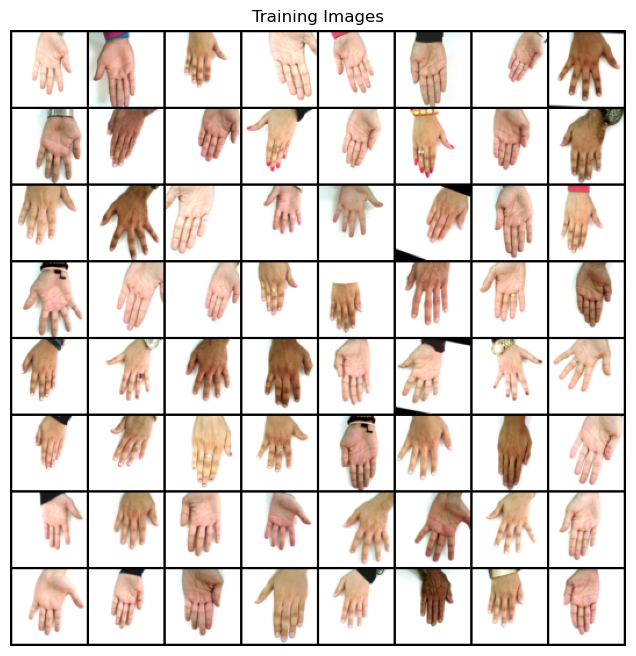

In [51]:
# 우리가 설정한 대로 이미지 데이터셋을 불러옵니다.
# 먼저 데이터셋을 만듭니다
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size), #           이미지 증강
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(), # 텐서값으로 변환 (커널이 읽을 수 있게 이미지를 배열로 변환)
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)), # 정규화
                           ]))
# dataloader를 정의합니다.
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# GPU 사용여부를 결정해줍니다.
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# 학습 데이터들 중 몇가지 이미지들을 화면에 띄웁니다.
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [52]:
# ``netG`` 와 ``netD`` 에 적용시킬 커스텀 가중치 초기화 함수 (시작점을 동일하게 두고 시작하기 위해?)
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [53]:
# 생성자 코드

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # 입력데이터 Z가 가장 처음 통과하는 전치 합성곱 계층입니다.
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # 위의 계층을 통과한 데이터의 크기. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # 위의 계층을 통과한 데이터의 크기. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # 위의 계층을 통과한 데이터의 크기. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # 위의 계층을 통과한 데이터의 크기. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # 위의 계층을 통과한 데이터의 크기. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

In [54]:
# 생성자를 만듭니다
netG = Generator(ngpu).to(device)

# 필요한 경우 multi-GPU를 설정합니다.
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# 모든 가중치의 평균을 0( ``mean=0`` ), 분산을 0.02( ``stdev=0.02`` )로 초기화하기 위해
# ``weight_init`` 함수를 적용시킵니다
netG.apply(weights_init)

# 모델의 구조를 출력합니다
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [55]:
# 판별자 코드

class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # 입력 데이터의 크기는 ``(nc) x 64 x 64`` 입니다
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # 위의 계층을 통과한 데이터의 크기. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # 위의 계층을 통과한 데이터의 크기. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # 위의 계층을 통과한 데이터의 크기. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # 위의 계층을 통과한 데이터의 크기. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [56]:
# 판별자를 만듭니다
netD = Discriminator(ngpu).to(device)

# 필요한 경우 multi-GPU를 설정합니다.
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# 모든 가중치의 평균을 0( ``mean=0`` ), 분산을 0.02( ``stdev=0.02`` )로 초기화하기 위해
# ``weight_init`` 함수를 적용시킵니다
netD.apply(weights_init)

# 모델의 구조를 출력합니다
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [57]:
# ``BCELoss`` 함수의 인스턴스를 초기화합니다
criterion = nn.BCELoss()

# 생성자의 학습상태를 확인할 잠재 공간 벡터를 생성합니다
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# 학습에 사용되는 참/거짓의 라벨을 정합니다
real_label = 1.
fake_label = 0.

# G와 D에서 사용할 Adam옵티마이저를 생성합니다
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [58]:
# 학습 과정 

# 학습상태를 체크하기 위해 손실값들을 저장합니다
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# 에폭(epoch) 반복
for epoch in range(num_epochs):
    # 한 에폭 내에서 배치 반복
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) D 신경망을 업데이트 합니다: log(D(x)) + log(1 - D(G(z)))를 최대화 합니다
        ###########################
        ## 진짜 데이터들로 학습을 합니다
        netD.zero_grad()
        # 배치들의 사이즈나 사용할 디바이스에 맞게 조정합니다
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label,
                           dtype=torch.float, device=device)
        # 진짜 데이터들로 이루어진 배치를 D에 통과시킵니다
        output = netD(real_cpu).view(-1)
        # 손실값을 구합니다
        errD_real = criterion(output, label)
        # 역전파의 과정에서 변화도를 계산합니다
        errD_real.backward()
        D_x = output.mean().item()

        ## 가짜 데이터들로 학습을 합니다
        # 생성자에 사용할 잠재공간 벡터를 생성합니다
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # G를 이용해 가짜 이미지를 생성합니다
        fake = netG(noise)
        label.fill_(fake_label)
        # D를 이용해 데이터의 진위를 판별합니다
        output = netD(fake.detach()).view(-1)
        # D의 손실값을 계산합니다
        errD_fake = criterion(output, label)
        # 역전파를 통해 변화도를 계산합니다. 이때 앞서 구한 변화도에 더합니다(accumulate)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # 가짜 이미지와 진짜 이미지 모두에서 구한 손실값들을 더합니다
        # 이때 errD는 역전파에서 사용되지 않고, 이후 학습 상태를 리포팅(reporting)할 때 사용합니다
        errD = errD_real + errD_fake
        # D를 업데이트 합니다
        optimizerD.step()

        ############################
        # (2) G 신경망을 업데이트 합니다: log(D(G(z)))를 최대화 합니다
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # 생성자의 손실값을 구하기 위해 진짜 라벨을 이용할 겁니다
        # 우리는 방금 D를 업데이트했기 때문에, D에 다시 가짜 데이터를 통과시킵니다.
        # 이때 G는 업데이트되지 않았지만, D가 업데이트 되었기 때문에 앞선 손실값가 다른 값이 나오게 됩니다
        output = netD(fake).view(-1)
        # G의 손실값을 구합니다
        errG = criterion(output, label)
        # G의 변화도를 계산합니다
        errG.backward()
        D_G_z2 = output.mean().item()
        # G를 업데이트 합니다
        optimizerG.step()

        # 훈련 상태를 출력합니다
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # 이후 그래프를 그리기 위해 손실값들을 저장해둡니다
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # fixed_noise를 통과시킨 G의 출력값을 저장해둡니다
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/50][0/113]	Loss_D: 1.8866	Loss_G: 5.5094	D(x): 0.6073	D(G(z)): 0.6575 / 0.0074
[0/50][50/113]	Loss_D: 2.3438	Loss_G: 25.5297	D(x): 0.9930	D(G(z)): 0.8530 / 0.0000
[0/50][100/113]	Loss_D: 0.2834	Loss_G: 3.1274	D(x): 0.9132	D(G(z)): 0.1268 / 0.0654
[1/50][0/113]	Loss_D: 0.6993	Loss_G: 4.8984	D(x): 0.8705	D(G(z)): 0.3554 / 0.0123
[1/50][50/113]	Loss_D: 0.2719	Loss_G: 4.4575	D(x): 0.9032	D(G(z)): 0.1241 / 0.0202
[1/50][100/113]	Loss_D: 0.2871	Loss_G: 3.0088	D(x): 0.8277	D(G(z)): 0.0733 / 0.0737
[2/50][0/113]	Loss_D: 0.0956	Loss_G: 5.6517	D(x): 0.9329	D(G(z)): 0.0212 / 0.0062
[2/50][50/113]	Loss_D: 0.0439	Loss_G: 5.3706	D(x): 0.9846	D(G(z)): 0.0273 / 0.0137
[2/50][100/113]	Loss_D: 0.0786	Loss_G: 4.8923	D(x): 0.9929	D(G(z)): 0.0663 / 0.0251
[3/50][0/113]	Loss_D: 0.0481	Loss_G: 5.1900	D(x): 0.9911	D(G(z)): 0.0377 / 0.0169
[3/50][50/113]	Loss_D: 0.6613	Loss_G: 0.6692	D(x): 0.5903	D(G(z)): 0.0738 / 0.5831
[3/50][100/113]	Loss_D: 0.6163	Loss_G: 5.6046	D(x): 0.9576	D(

[32/50][100/113]	Loss_D: 0.4035	Loss_G: 1.3535	D(x): 0.7147	D(G(z)): 0.0234 / 0.3235
[33/50][0/113]	Loss_D: 0.2391	Loss_G: 3.4805	D(x): 0.9336	D(G(z)): 0.1441 / 0.0445
[33/50][50/113]	Loss_D: 0.9021	Loss_G: 5.4308	D(x): 0.9502	D(G(z)): 0.5025 / 0.0093
[33/50][100/113]	Loss_D: 0.2554	Loss_G: 2.9206	D(x): 0.8266	D(G(z)): 0.0396 / 0.0822
[34/50][0/113]	Loss_D: 0.2928	Loss_G: 3.0941	D(x): 0.9267	D(G(z)): 0.1728 / 0.0661
[34/50][50/113]	Loss_D: 0.3143	Loss_G: 3.8228	D(x): 0.9636	D(G(z)): 0.2173 / 0.0294
[34/50][100/113]	Loss_D: 0.3693	Loss_G: 3.1913	D(x): 0.9080	D(G(z)): 0.2117 / 0.0627
[35/50][0/113]	Loss_D: 0.3019	Loss_G: 3.9949	D(x): 0.9283	D(G(z)): 0.1855 / 0.0255
[35/50][50/113]	Loss_D: 0.1882	Loss_G: 3.3894	D(x): 0.9095	D(G(z)): 0.0829 / 0.0515
[35/50][100/113]	Loss_D: 0.2010	Loss_G: 2.7984	D(x): 0.8659	D(G(z)): 0.0391 / 0.0881
[36/50][0/113]	Loss_D: 0.1618	Loss_G: 3.9781	D(x): 0.9229	D(G(z)): 0.0709 / 0.0295
[36/50][50/113]	Loss_D: 0.4239	Loss_G: 1.9974	D(x): 0.7449	D(G(z)): 0.0897 /

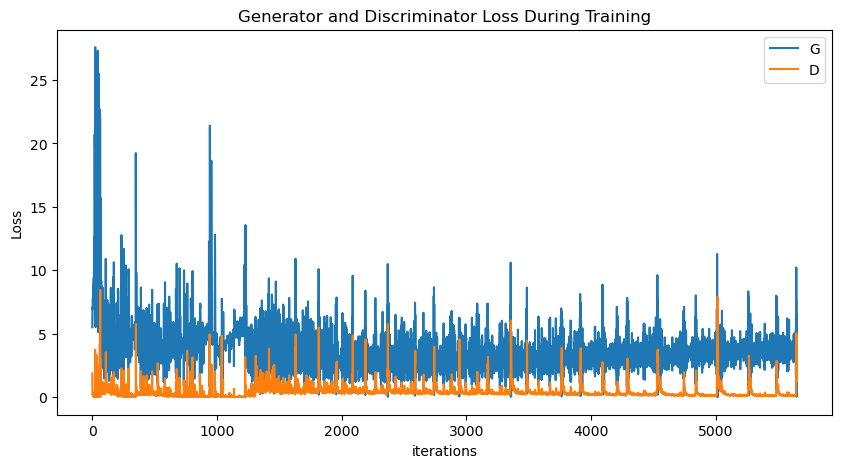

In [59]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

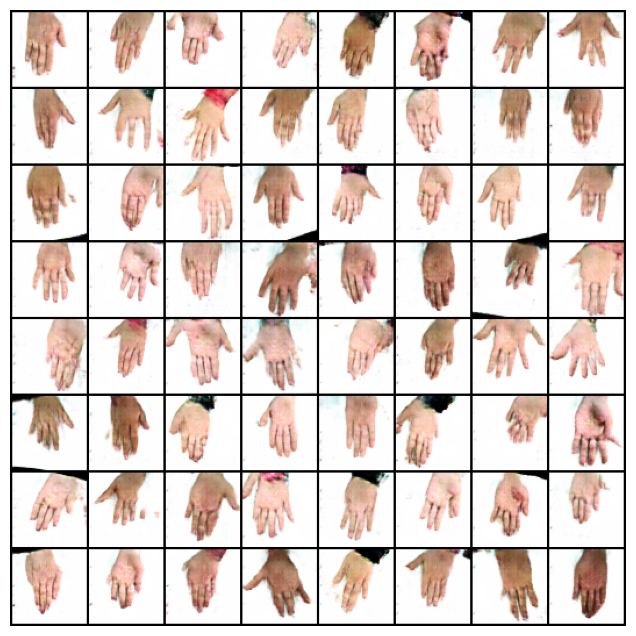

In [12]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [6]:
# 이미지 목록 확인
for i, img in enumerate(img_list):
    plt.subplot(1, len(img_list), i + 1)
    plt.imshow(np.transpose(img, (1, 2, 0)))
    plt.axis("off")
plt.show()

NameError: name 'plt' is not defined

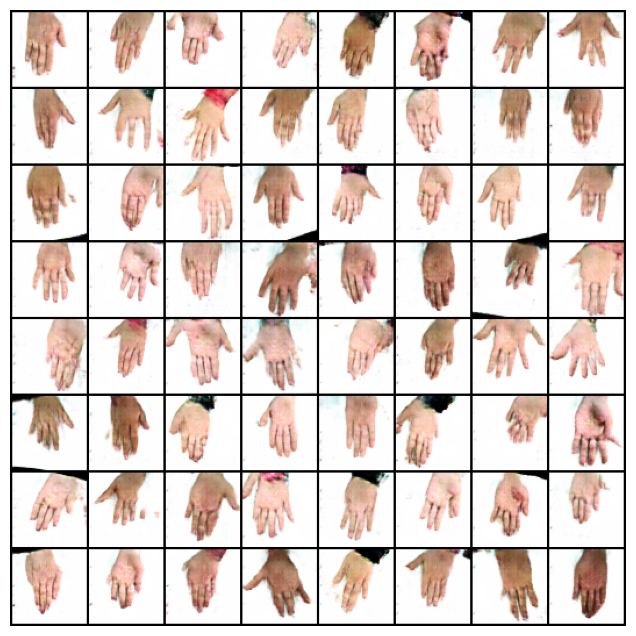

In [61]:
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# img_list가 이미지의 목록이라고 가정합니다.

fig = plt.figure(figsize=(8, 8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i, (1, 2, 0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

# 애니메이션을 GIF로 저장 (Pillow 사용)
ani.save('hand.gif', writer='pillow', fps=1)

HTML(ani.to_jshtml())

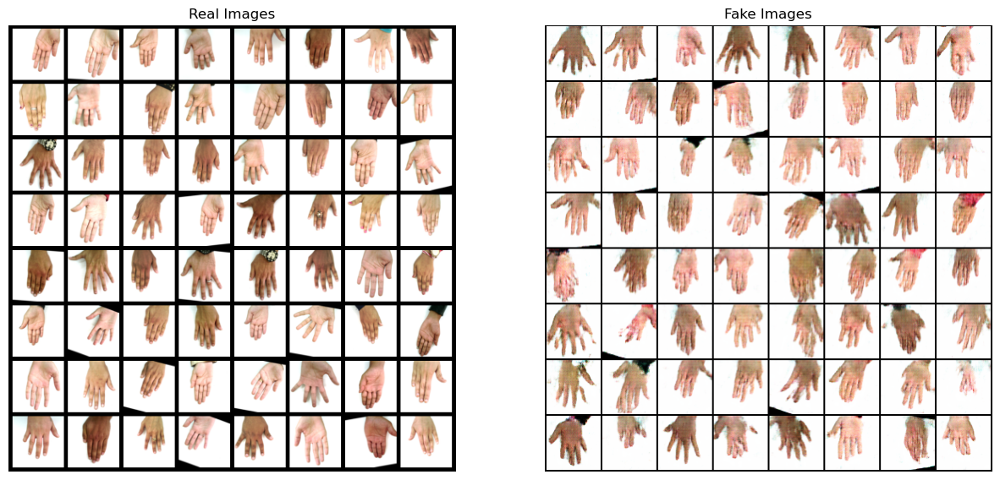

In [28]:
# dataloader에서 진짜 데이터들을 가져옵니다
real_batch = next(iter(dataloader))

# 진짜 이미지들을 화면에 출력합니다
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# 가짜 이미지들을 화면에 출력합니다
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

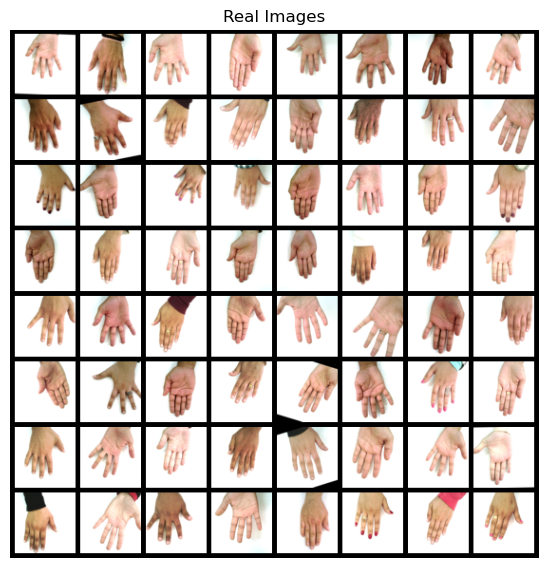

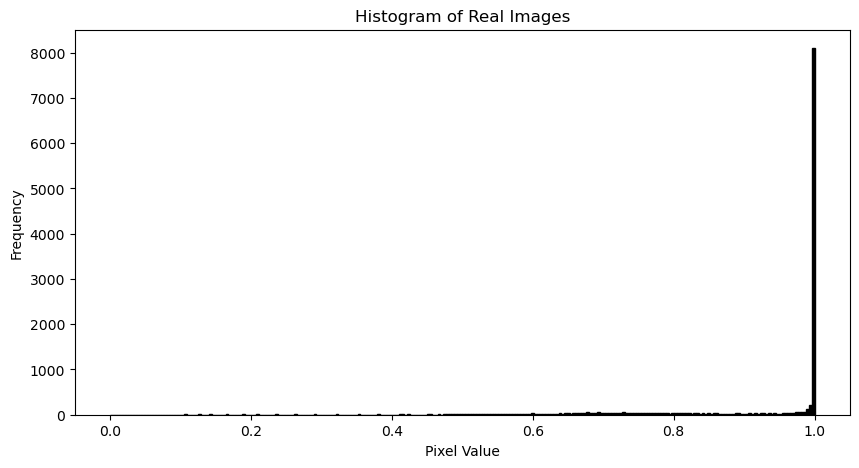

In [15]:
# 데이터셋의 경로
dataroot = "dataset/Hands"

# dataloader에서 사용할 쓰레드 수
workers = 2

# 배치 크기
batch_size = 128

# 이미지의 크기입니다. 모든 이미지를 변환하여 64로 크기가 통일됩니다.
image_size = 64

# 우리가 설정한 대로 이미지 데이터셋을 불러옵니다.
# 먼저 데이터셋을 만듭니다
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size), #           이미지 증강
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(), # 텐서값으로 변환 (커널이 읽을 수 있게 이미지를 배열로 변환)
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)), # 정규화
                           ]))
# dataloader를 정의합니다.
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# GPU 사용여부를 결정해줍니다.
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# dataloader에서 진짜 데이터들을 가져옵니다
real_batch = next(iter(dataloader))

# 진짜 이미지들을 화면에 출력합니다
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

real_images = real_batch[0]  

# 진짜 이미지 데이터를 사용하므로, img_list[-1] 대신 real_images를 사용
real_images = real_images[0]  # 첫 번째 이미지만 선택
real_images = np.transpose(real_images, (1, 2, 0))  # 축 변환
real_images = (real_images + 1) / 2  # -1 ~ 1 범위에서 0 ~ 1 범위로 변환
real_images = np.clip(real_images, 0, 1)  # 범위를 0 ~ 1로 제한

# 히스토그램 생성
plt.figure(figsize=(10, 5))
plt.title("Histogram of Real Images")
plt.hist(real_images.ravel(), bins=256, range=(0.0, 1.0), fc='k', ec='k')
plt.xlabel("Pixel Value")
plt.ylabel("Frequency")
plt.show()

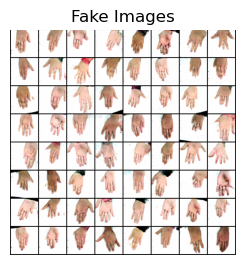

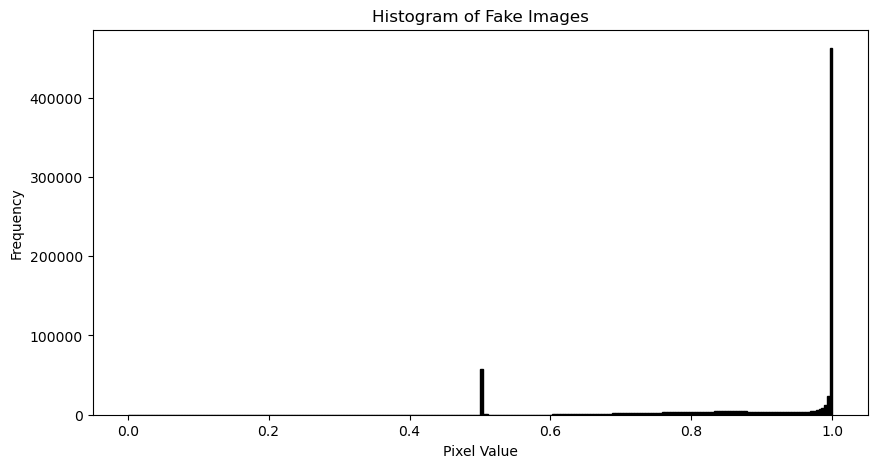

In [8]:
# 가짜 이미지들을 화면에 출력합니다
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

# 가짜 이미지의 히스토그램을 생성합니다
fake_images = img_list[-1]
fake_images = fake_images.numpy()
fake_images = np.transpose(fake_images, (1, 2, 0))
fake_images = (fake_images + 1) / 2  # -1 ~ 1 범위에서 0 ~ 1 범위로 변환
fake_images = np.clip(fake_images, 0, 1)  # 범위를 0 ~ 1로 제한

# 히스토그램 생성
plt.figure(figsize=(10, 5))
plt.title("Histogram of Fake Images")
plt.hist(fake_images.ravel(), bins=256, range=(0.0, 1.0), fc='k', ec='k')
plt.xlabel("Pixel Value")
plt.ylabel("Frequency")
plt.show()

In [64]:
for images in data_loader:
    print(images.shape)
    new_img_list.extend(images)

torch.Size([13, 3, 530, 530])


In [66]:
#Inception Score 평가
import numpy as np
import torch
import torchvision.transforms as transforms
from torchvision.models import inception_v3
from scipy.stats import entropy
from torch.utils.data import DataLoader

# 미리 학습된 Inception 모델 로드
inception_model = inception_v3(pretrained=True, transform_input=False, aux_logits=False)
inception_model.eval()

# 이미지 변환을 위한 전처리 함수 정의
preprocess = transforms.Compose([
    transforms.Resize(299),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

# Inception Score 계산 함수 정의
def calculate_inception_score(images):
    batch_size = 32
    num_images = len(images)
    num_batches = int(np.ceil(num_images / batch_size))
    scores = []

    for i in range(num_batches):
        start_idx = i * batch_size
        end_idx = (i + 1) * batch_size
        batch_images = images[start_idx:end_idx]
        batch_images = torch.stack([preprocess(img) for img in batch_images])

        # Inception 모델에 입력하여 logits 계산
        logits = inception_model(batch_images)

        # softmax를 통해 확률로 변환
        probs = torch.nn.functional.softmax(logits, dim=1)

        # 확률 분포의 엔트로피 계산
        entropy_scores = entropy(probs.detach().numpy().T)

        # Inception Score 계산
        inception_score = np.exp(np.mean(entropy_scores))
        scores.append(inception_score)

    # 전체 이미지에 대한 Inception Score의 평균 계산
    mean_inception_score = float(np.mean(scores))
    return mean_inception_score

# 생성된 이미지를 담고 있는 데이터셋과 데이터로더
generated_dataset = [...]  # 생성된 이미지 데이터셋을 여기에 입력해주세요.
data_loader = DataLoader(generated_dataset, batch_size=32, shuffle=True)

# 데이터로더를 통해 이미지 리스트에 이미지 추가
for images, _ in data_loader:
    img_list.extend(images)

# 이미지 리스트를 넘파이 배열로 변환
image_array = np.array(img_list)

# Inception Score 계산
inception_score = calculate_inception_score(image_array)

print("Inception Score:", inception_score)

TypeError: Cannot handle this data type: (1, 1, 530), <f4

In [ ]:
# #inception_score 시각화

import matplotlib.pyplot as plt

# 진짜 이미지의 Inception Score 계산
real_images_inception_score = calculate_inception_score(real_image_array)  # real_image_array는 진짜 이미지 데이터를 담고 있는 배열을 가정합니다.

# 가짜 이미지의 Inception Score 계산
fake_images_inception_score = calculate_inception_score(np.array(new_img_list))  # new_img_list를 np.array로 변환하여 Inception Score를 계산합니다.

# 그래프 데이터 설정
labels = ['Real Images', 'Fake Images']
scores = [real_images_inception_score, fake_images_inception_score]

# 그래프 그리기
plt.bar(labels, scores)
plt.xlabel('Image Type')
plt.ylabel('Inception Score')
plt.title('Inception Score Comparison')
plt.show()

In [68]:
import pickle

# img_list를 'img_list.pkl' 파일로 저장
with open('img_list.pkl', 'wb') as f:
    pickle.dump(img_list, f)

In [3]:
import pickle
# 'img_list.pkl' 파일에서 img_list를 불러옴
with open('img_list.pkl', 'rb') as f:
    img_list = pickle.load(f)

In [7]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML